In [153]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.metrics import mean_absolute_error, mean_squared_error, median_absolute_error, make_scorer


In [154]:
# Create your connection and export lifts table into csv

df = pd.read_csv(r"lifts.csv")
comp_df = pd.read_csv(r"comp.csv")

In [3]:
# Add date
lift_df = pd.merge(df, comp_df, how='left', on='competition_id')
lift_df.head()

# Convert the dates to datetime format
lift_df['date'] = pd.to_datetime(lift_df['date'], errors='coerce')

lift_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118854 entries, 0 to 118853
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   competition_id  118854 non-null  int64         
 1   lifter_id       118854 non-null  int64         
 2   sex             118854 non-null  int64         
 3   age             118854 non-null  int64         
 4   age_div_id      118854 non-null  int64         
 5   weight_div_id   118854 non-null  int64         
 6   weight          118854 non-null  float64       
 7   squat           118854 non-null  float64       
 8   bench           118854 non-null  float64       
 9   deadlift        118854 non-null  float64       
 10  total           118854 non-null  float64       
 11  date            118854 non-null  datetime64[ns]
 12  name            118854 non-null  object        
dtypes: datetime64[ns](1), float64(5), int64(6), object(1)
memory usage: 11.8+ MB


In [4]:
lift_df['competition_id'].unique().shape
lift_df.groupby(['competition_id']).count() #3459

#lift_df['name'].unique().shape
#lift_df.groupby(['competition_id']).count() #371
#lift_df.head()

,lifter_id,sex,age,age_div_id,weight_div_id,weight,squat,bench,deadlift,total,date,name
competition_id,,,,,,,,,,,,
7,13,13,13,13,13,13,13,13,13,13,13,13
12,40,40,40,40,40,40,40,40,40,40,40,40
16,87,87,87,87,87,87,87,87,87,87,87,87
18,7,7,7,7,7,7,7,7,7,7,7,7
334,7,7,7,7,7,7,7,7,7,7,7,7
...,...,...,...,...,...,...,...,...,...,...,...,...
121047,24,24,24,24,24,24,24,24,24,24,24,24
121048,20,20,20,20,20,20,20,20,20,20,20,20
121049,26,26,26,26,26,26,26,26,26,26,26,26


In [5]:
# Remove unnecessary columns

# Removes Rows where any lift is negative
lift_df = lift_df[lift_df.bench > 0]
lift_df = lift_df[lift_df.squat > 0]
lift_df = lift_df[lift_df.deadlift > 0]

lift_df = lift_df.drop(columns=['age_div_id', 'weight_div_id'], axis=1)
lift_df = lift_df.drop(columns=['name'], axis=1)

# Drop columns where sex is unspecified #489
# lift_df.drop(columns=['Unnamed: 0_x', 'Unnamed: 0_y'], axis=1,inplace=True)
# #lift_df = lift_df.drop(columns=['competition_id' ,'name_x','state_x'], axis=1)

# lift_df = lift_df.drop(columns=['competition_id','name_x', 'placing','state_x', 'competitors'], axis=1)
# #lift_df = lift_df.drop(columns=['unnamed'], axis=1)
# lift_df = lift_df.drop(columns=['bp_points', 'drug_tested'], axis=1)
# lift_df = lift_df.drop(columns=['bench1', 'bench2', 'bench3', 'squat1', 'squat2', 'squat3', 'deadlift1', 'deadlift2', 'deadlift3'], axis=1)
# lift_df = lift_df.drop(columns=['YOB', 'points', 'team', 'lot'], axis=1)
# #lift_df = lift_df.drop(columns=['competition_id', 'lifter_id', 'event', 'state_x'], axis=1)
# lift_df = lift_df.drop(columns=['event'], axis=1)
# lift_df = lift_df.drop(columns=['name_y', 'sanction', 'state_y','url','processed'])
# lift_df = lift_df.drop(columns=['bench', 'squat' ,'deadlift'], axis=1)

lift_df.head()

,competition_id,lifter_id,sex,age,weight,squat,bench,deadlift,total,date
0,7,2207,0,57,53.9,72.5,50.0,92.5,215.0,2014-08-23
2,7,2204,0,46,66.3,90.0,65.0,107.5,262.5,2014-08-23
3,7,13736,0,27,76.0,167.5,85.0,165.0,417.5,2014-08-23
4,7,2202,1,23,59.6,87.5,87.5,105.0,280.0,2014-08-23
5,7,2199,1,36,73.7,195.0,115.0,195.0,505.0,2014-08-23


<Axes: >

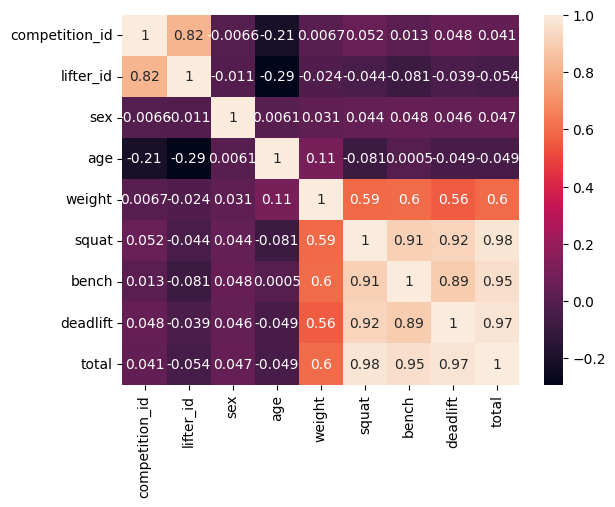

In [8]:
# Relationship Analysis
numeric_df = lift_df.select_dtypes(include=[np.number])
correlation = numeric_df.corr()

sns.heatmap(correlation, xticklabels=correlation.columns, yticklabels=correlation.columns,annot=True)

# Key takeaways:
# - Weight is  positively correlated to strength. To be stronger, it is strongly advised to gain weight.
# - Age is slightly and weakly negatively corrected to strength. The older the lifter, the less they can lift

# Discussion
# - If Weight is only 50-60 percent correlated to strength(total), then what explains the other half? What other feature(s)
# are needed in order to confidently predict one's strength(total)?
# - Experience level needs to be investigated and explored in hopes of improving the prediction of a lifter's total

# Key takeaways 2:
# - Experience level was investigated and is weakly positivly correlated to strength(total) 0.15
# - When scoping within the -75 weight class, weight was less correlated to total strength 0.38

# Discussion 2:
# - There is a lot of variability still so strength can't be predicted.
# - I strongly believe genetics is highly involved for this variability (mechanical leverage, muscle fiber composition, etc)
# - To remove genetics, We shouldn't compare lifter's strength with each other bc each lifter has their own unique genetics
# -> Look at progress of strength total for each lifter and normalize it
# -> Ex.) (20week difference)
# ->        Good genetics: 100kg squat -> 110kg squat
# ->        Bad genetics: 50kg squat -> 15kg squat
# ->    Both increases their strength by 10%, so they are equally progressing
# ->    NOTE: (This assumes they have the same genetics determining the rate of muscle growth)
# ->    NOTE: (Rate of progress slows for advance lifters, so will scew results in that more training experience is negatively correlated to strength)

# Add bulking-coefficient (weeks passed)*(weight*gained)


# Adjust strength difference calculation
# -> Strength difference is not linear, the more experienced a lifter is, the less expected 'gains' they experience per week
# -> Find model for strength gain that fits onto the data more accurately regarding training experience (expecting logarithmic)




In [9]:
sns.pairplot(lift_df, hue='sex',)

In [6]:
# Function to calculate weeks difference
def calculate_weeks_difference(group):
    # Ensure the 'date' column is of datetime type
    group['date'] = pd.to_datetime(group['date'])

    group['powerlifting_comp_experience'] = group['date'].apply(lambda x: round((x - group['date'].min()).days / 7), 1)
    return group

# Apply the function to each group
lift_df = lift_df.groupby('lifter_id').apply(calculate_weeks_difference).reset_index(drop=True)
lift_df.info()

/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/514176980.py:6: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  group['powerlifting_comp_experience'] = group['date'].apply(lambda x: round((x - group['date'].min()).days / 7), 1)
/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/514176980.py:6: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  group['powerlifting_comp_experience'] = group['date'].apply(lambda x: round((x - group['date'].min()).days / 7), 1)
/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/514176980.py:6: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dt

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103532 entries, 0 to 103531
Data columns (total 11 columns):
 #   Column                        Non-Null Count   Dtype         
---  ------                        --------------   -----         
 0   competition_id                103532 non-null  int64         
 1   lifter_id                     103532 non-null  int64         
 2   sex                           103532 non-null  int64         
 3   age                           103532 non-null  int64         
 4   weight                        103532 non-null  float64       
 5   squat                         103532 non-null  float64       
 6   bench                         103532 non-null  float64       
 7   deadlift                      103532 non-null  float64       
 8   total                         103532 non-null  float64       
 9   date                          103532 non-null  datetime64[ns]
 10  powerlifting_comp_experience  103532 non-null  int64         
dtypes: datetime64

/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/514176980.py:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  lift_df = lift_df.groupby('lifter_id').apply(calculate_weeks_difference).reset_index(drop=True)


In [14]:
# Function to calculate strength difference from lifter's first total
def calculate_strength_difference(group):
    first_lift_squat = group.sort_values(by='date')['squat'].iloc[0]
    first_lift_bench = group.sort_values(by='date')['bench'].iloc[0]
    first_lift_deadlift = group.sort_values(by='date')['deadlift'].iloc[0]
    first_weight = group.sort_values(by='date')['weight'].iloc[0]
    group['squat_difference'] = (group['squat'] / first_lift_squat) * 100
    group['bench_difference'] = (group['bench'] / first_lift_bench) * 100
    group['deadlift_difference'] = (group['deadlift'] / first_lift_deadlift) * 100
    group['body_squat_ratio'] = first_lift_squat / first_weight
    group['body_bench_ratio'] = first_lift_bench / first_weight
    group['body_deadlift_ratio'] = first_lift_deadlift / first_weight

    return group

# Apply the function to each group
lift_df = lift_df.groupby('lifter_id').apply(calculate_strength_difference).reset_index(drop=True)

/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/2990486133.py:11: RuntimeWarning: divide by zero encountered in scalar divide
  group['body_squat_ratio'] = first_lift_squat / first_weight
/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/2990486133.py:12: RuntimeWarning: divide by zero encountered in scalar divide
  group['body_bench_ratio'] = first_lift_bench / first_weight
/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/2990486133.py:13: RuntimeWarning: divide by zero encountered in scalar divide
  group['body_deadlift_ratio'] = first_lift_deadlift / first_weight
/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/2990486133.py:18: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping colu

In [10]:
# Function to calculate weight difference from lifter's first lift
def calculate_weight_difference(group):
    first_weight = group.sort_values(by='date')['weight'].iloc[0]
    group['weight_difference'] = (group['weight'] - first_weight)
    return group

# Apply the function to each group
lift_df = lift_df.groupby('lifter_id').apply(calculate_weight_difference).reset_index(drop=True)

/var/folders/j1/xjzx6k4n5_53bfxbf3hhk4cw0000gn/T/ipykernel_54415/726560241.py:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  lift_df = lift_df.groupby('lifter_id').apply(calculate_weight_difference).reset_index(drop=True)


In [11]:
# Add bulking coefficient (weeks passed)* (binary weight gained=-1 or 1)
lift_df['bulk_coefficient'] = lift_df['powerlifting_comp_experience'] * (lift_df['weight_difference'])

In [155]:
# Build test dataset for training models
clean_df = lift_df

#clean_df = pd.get_dummies(clean_df, columns=['age_div', 'weight_div'])
#clean_df = pd.get_dummies(clean_df, columns=['age_div'])

# Convert all boolean columns to integers (0 or 1)
clean_df = clean_df.apply(lambda x: x.astype(int) if x.dtype == 'bool' else x)
clean_df = clean_df.drop(columns=['lifter_id', 'date'])
clean_df = clean_df.drop(columns=['competition_id'])
# convert ratio columns float values into one decimal place
clean_df['body_squat_ratio'] = clean_df['body_squat_ratio'].apply(lambda x: round(x, 1))
clean_df['body_bench_ratio'] = clean_df['body_bench_ratio'].apply(lambda x: round(x, 1))
clean_df['body_deadlift_ratio'] = clean_df['body_deadlift_ratio'].apply(lambda x: round(x, 1))

# Remove rows with negative values
clean_df = clean_df[clean_df['weight'] > 0]
# clean_df = clean_df[clean_df['powerlifting_comp_experience'] > 0]

# Squat dataset
squat_df = clean_df.drop(columns=['bench_difference', 'deadlift_difference', 'bench', 'deadlift', 'total', 'body_deadlift_ratio', 'body_bench_ratio'])
# Bench dataset
bench_df = clean_df.drop(columns=['squat_difference', 'deadlift_difference', 'squat', 'deadlift', 'total', 'body_squat_ratio', 'body_deadlift_ratio'])
# Deadlift dataset
deadlift_df = clean_df.drop(columns=['squat_difference', 'bench_difference', 'squat', 'bench', 'total', 'body_squat_ratio', 'body_bench_ratio'])

deadlift_df = deadlift_df.drop(deadlift_df[(deadlift_df.powerlifting_comp_experience == 0) & (deadlift_df.deadlift_difference != 100.0)].index)
deadlift_df = deadlift_df
deadlift_df[(deadlift_df.powerlifting_comp_experience == 0) & (deadlift_df.deadlift_difference != 100.0)].describe()

,sex,age,weight,deadlift,powerlifting_comp_experience,deadlift_difference,body_deadlift_ratio,weight_difference,bulk_coefficient
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [157]:
# Remove rows with NaN values, missing values, or infinite values
def clean_data(clean_df):
    if clean_df.isnull().values.any() or clean_df.isna().values.any() or clean_df.isin([np.inf]).values.any() or clean_df.isin([-np.inf]).values.any():
        print("Data contains NaN. Need cleaning or preprocessing.")
        # Remove rows with NaN values
        clean_df = clean_df.dropna()

        # Remove rows with missing values
        clean_df = clean_df.dropna()

        # Remove rows with infinite values
        clean_df = clean_df.replace([np.inf, -np.inf], np.nan).dropna()

    else:
        print("Data is clean")
    return clean_df

squat_df = clean_data(squat_df)
bench_df = clean_data(bench_df)
deadlift_df = clean_data(deadlift_df)

Data is clean
Data is clean
Data is clean


In [158]:
# Create datasets for squat, bench, and deadlift

squat_X = squat_df.drop(columns=['squat_difference'])
squat_Y = squat_df['squat_difference']

bench_X = bench_df.drop(columns=['bench_difference'])
bench_Y = bench_df['bench_difference']

deadlift_X = deadlift_df.drop(columns=['deadlift_difference'])
deadlift_Y = deadlift_df['deadlift_difference']

Random Search Grid

In [159]:
# Training Test Split

squat_x_train, squat_x_test, squat_y_train, squat_y_test = train_test_split(squat_X, squat_Y, test_size=0.2, random_state=27)
bench_x_train, bench_x_test, bench_y_train, bench_y_test = train_test_split(bench_X, bench_Y, test_size=0.2, random_state=27)
deadlift_x_train, deadlift_x_test, deadlift_y_train, deadlift_y_test = train_test_split(deadlift_X, deadlift_Y, test_size=0.2, random_state=27)

# Show the results of the split
print("Training set has squat{}, bench{}, deadlift{} samples.".format(squat_x_train.shape[0], bench_x_train.shape[0], deadlift_x_train.shape[0]))
print("Testing set has sqaut{}, bench{}, deadlift{} samples.".format(squat_x_test.shape[0], bench_x_test.shape[0], deadlift_x_test.shape[0]))


Training set has squat82783, bench82783, deadlift82636 samples.
Testing set has sqaut20696, bench20696, deadlift20659 samples.


In [160]:
# Create function that returns a prediction interval for random forest regressor so that 95% of the predicted data falls within the interval
def median_mean_scoring(y_true, predictions):
    """
    Takes in a model, x_test, and percentile paramater
    The percentile parameter represents how much of the predicted data should fall within the interval
    Returns Score based on -(Median Absolute Error) + -(Interval)
        The lower the score, the better the model
        Lower MAE = Less residual error
        Lower Interval = More accurate prediction
    """
    # Make a prediction
    return -(median_absolute_error(y_true, predictions)) -(mean_absolute_error(y_true, predictions))

# Wrap the custom score function using make_scorer
median_mean_score = make_scorer(median_mean_scoring, greater_is_better=True, needs_proba=False, needs_threshold=False)



/opt/homebrew/lib/python3.11/site-packages/sklearn/metrics/_scorer.py:548: FutureWarning: The `needs_threshold` and `needs_proba` parameter are deprecated in version 1.4 and will be removed in 1.6. You can either let `response_method` be `None` or set it to `predict` to preserve the same behaviour.
  warnings.warn(


In [161]:
# For RandomForestRegressor
# Best RandomForestRegressor Parameters:
# Best GradientBoostingRegressor Parameters: {'subsample': 0.4, 'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.2}

rf_param_grid = {
    'n_estimators': [25, 50, 75, 100, 125, 150, 175, 200, 225, 250, 275, 300],
    'max_features': [1, 2, 3, 4, 5, 6, 7, 8],
    'max_depth': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
    'min_samples_split': [2,3,4, 6, 8, 10, 12, 14, 16, 18, 20],
    'min_samples_leaf': [2, 3, 4, 6, 8, 10, 12, 14, 16, 18, 20]
}
# Best RandomForestRegressor Parameters: {'n_estimators': 275, 'min_samples_split': 3, 'min_samples_leaf': 3, 'max_features': 7, 'max_depth': 9}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 250, 'max_depth': 8, 'learning_rate': 0.1}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 350, 'max_depth': 12, 'learning_rate': 0.1}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 500, 'max_depth': 10, 'learning_rate': 0.05}
# For GradientBoostingRegressor
gb_param_grid = {
    'n_estimators': [450, 500, 600, 700, 800],
    'learning_rate': [0.01, 0.05, 0,1, 0.15, 0.2],
    'subsample': [0.4, 0.5, 0.6],
    'max_depth': [8, 10, 12, 14]
}


n_itern = 100
         
rf_random_search_squat = RandomizedSearchCV(RandomForestRegressor(), param_distributions=rf_param_grid, 
                                      n_iter=n_itern, scoring=median_mean_score, 
                                      cv=5, verbose=1, n_jobs=-1, random_state=27)

gb_random_search_squat = RandomizedSearchCV(GradientBoostingRegressor(), param_distributions=gb_param_grid, 
                                      n_iter=n_itern, scoring=median_mean_score, 
                                      cv=5, verbose=1, n_jobs=-1, random_state=27)

rf_random_search_bench = RandomizedSearchCV(RandomForestRegressor(), param_distributions=rf_param_grid, 
                                      n_iter=n_itern, scoring=median_mean_score, 
                                      cv=5, verbose=1, n_jobs=-1, random_state=27)

gb_random_search_bench = RandomizedSearchCV(GradientBoostingRegressor(), param_distributions=gb_param_grid, 
                                      n_iter=n_itern, scoring=median_mean_score, 
                                      cv=5, verbose=1, n_jobs=-1, random_state=27)

rf_random_search_deadlift = RandomizedSearchCV(RandomForestRegressor(), param_distributions=rf_param_grid, 
                                      n_iter=n_itern, scoring=median_mean_score, 
                                      cv=5, verbose=1, n_jobs=-1, random_state=27)

gb_random_search_deadlift = RandomizedSearchCV(GradientBoostingRegressor(), param_distributions=gb_param_grid, 
                                      n_iter=n_itern, scoring=median_mean_score, 
                                      cv=5, verbose=1, n_jobs=-1, random_state=27)



In [162]:
# rf_random_search_squat.fit(squat_x_train, squat_y_train)
# gb_random_search_squat.fit(squat_x_train, squat_y_train)

# rf_random_search_bench.fit(bench_x_train, bench_y_train)
# gb_random_search_bench.fit(bench_x_train, bench_y_train)

# rf_random_search_deadlift.fit(deadlift_x_train, deadlift_y_train)
gb_random_search_deadlift.fit(deadlift_x_train, deadlift_y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/opt/homebrew/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


RandomizedSearchCV(cv=5, estimator=GradientBoostingRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.05, 0.1, 0.15, 0.2,
                                                          0.3],
                                        'max_depth': [8, 10, 12, 14, 16, 18,
                                                      20],
                                        'n_estimators': [300, 350, 400, 450,
                                                         500],
                                        'subsample': [0.3, 0.4, 0.5, 0.6, 0.7]},
                   random_state=27,
                   scoring=make_scorer(median_mean_scoring, response_method='predict'),
                   verbose=1)

In [166]:
# Evaluate model performance and see percentage of predicted values falls within specified confidence band
def print_evaluate_model(model, x_test, y_test, uncertainty) -> float:
    preds = model.predict(x_test)
    satisfies = y_test - preds
    satisfies = satisfies[satisfies.abs() <= uncertainty]
    print(f'Model: {(len(satisfies) / len(preds)) * 100}% of the predictions are within the uncertainty range')
    mean_satisfies = y_test - np.mean(y_test)
    mean_satisfies = mean_satisfies[mean_satisfies.abs() <= uncertainty]
    print(f'Mean: {(len(mean_satisfies) / len(preds)) * 100}% of the predictions are within the uncertainty range')

# print_evaluate_model(gb_random_search_squat, squat_x_test, squat_y_test, 2.5)
#print_evaluate_model(gb_random_search_bench, bench_x_test, bench_y_test, 2.5)
print_evaluate_model(gb_random_search_deadlift, deadlift_x_test, deadlift_y_test, 4)

# Evaluate deadlift prediction +- 4% Powerlifting Comp Experience includes 0

    # gb_random_search_deadlift
    # Model: 95.27566677961178% of the predictions are within the uncertainty range
    # Mean: 14.453748971392613% of the predictions are within the uncertainty range


    # gb_random_search_deadlift
    # Model: 94.52068032470042% of the predictions are within the uncertainty range
    # Mean: 14.853111712408197% of the predictions are within the uncertainty range

    # rf_random_search_deadlift
    # Model: 72.91264012369541% of the predictions are within the uncertainty range
    # Mean: 14.853111712408197% of the predictions are within the uncertainty range


# Evaluate bench prediction +- 5% Powerlifting Comp Experience includes 0

    # gb_random_search_bench
    # Model: 93.82006184770005% of the predictions are within the uncertainty range
    # Mean: 8.36876691148048% of the predictions are within the uncertainty range

    # rf_random_search_bench
    # Model: 74.62311557788944% of the predictions are within the uncertainty range
    # Mean: 15.785659064553537% of the predictions are within the uncertainty range



# Evaluate squat prediction +- 5% Powerlifting Comp Experience includes 0

    # gb_random_search_squat
    # Model: 96.50173946656359% of the predictions are within the uncertainty range
    # Mean: 7.82276768457673% of the predictions are within the uncertainty range

    # rf_random_search_squat
    # Model: 66.86799381523% of the predictions are within the uncertainty range
    # Mean: 7.82276768457673% of the predictions are within the uncertainty range

    # ada_random_search (Do not use)
    # Model: 32.48606465997771% of the predictions are within the uncertainty range
    # Mean: 22.34113712374582% of the predictions are within the uncertainty range


# Without Squat/Bench/Deadlift to weight ratio
# Evaluate Total (squat + bench + deadlift) prediction +- 5% Powerlifting Comp Experience > 0
# bodyweight ratio
#rf_random_search
# Model: 45.48088710576173% of the predictions are within the uncertainty range
# Mean: 27.482447342026077% of the predictions are within the uncertainty range

#gb_random_search
# Model: 47.54262788365095% of the predictions are within the uncertainty range
# Mean: 27.482447342026077% of the predictions are within the uncertainty range

# No bodyweight ratio
#rf_random_search
# Model: 46.3724506853895% of the predictions are within the uncertainty range
# Mean: 28.56346818232475% of the predictions are within the uncertainty range

#gb_random_search
# Model: 47.62063969686838% of the predictions are within the uncertainty range
# Mean: 28.56346818232475% of the predictions are within the uncertainty range


Model: 95.27566677961178% of the predictions are within the uncertainty range
Mean: 14.453748971392613% of the predictions are within the uncertainty range


In [114]:
# Feature Importance
#print(clr.feature_importances_)
#print(clr.feature_names_in_)
#['age'     'weight'   'total' '   powerlifting_comp_experience' 'weight_difference', 'sex_encoded']
#[0.11061381 0.19520595 0.14816942 0.31539404                     0.22340368           0.0072131 ]
print(gb_random_search.best_estimator_.feature_names_in_)
# ['sex'        'age'     'weight' 'squat'      'powerlifting_comp_experience' 'weight_difference' 'bulk_coefficient' 'body_squat_ratio']
# [0.00204595 0.05087638 0.1514156  0.29455693 0.03810577                       0.04527018,          0.11935013         0.29837904]

['sex' 'age' 'weight' 'squat' 'powerlifting_comp_experience'
 'weight_difference' 'bulk_coefficient' 'body_squat_ratio']


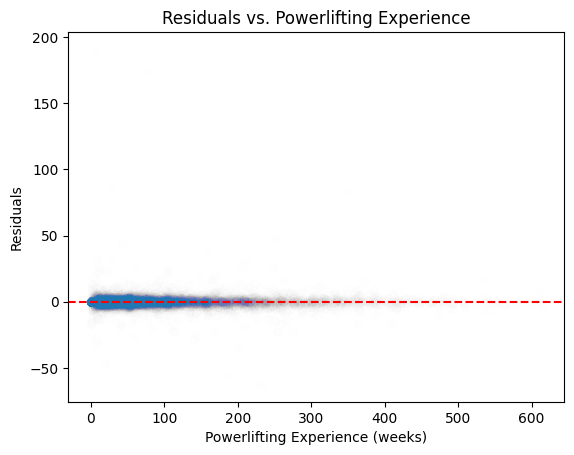

In [167]:
# Create a function that takes in a model and create a histogram of residuals against powerlifting_comp_experience
def plot_residuals(model, x_test, y_test):
    """
    Takes in a model, x_test, and y_test
    Plots the residuals against powerlifting_comp_experience
    """
    # Make a prediction
    predictions = model.predict(x_test)

    # Calculate the residuals
    residuals = y_test - predictions

    # Plot the residuals
    plt.scatter(x_test['powerlifting_comp_experience'], residuals, alpha=0.002)
    plt.axhline(y=0, color='r', linestyle='--')
    plt.title('Residuals vs. Powerlifting Experience')
    plt.xlabel('Powerlifting Experience (weeks)')
    plt.ylabel('Residuals')
    plt.show()

# Example usage
#plot_residuals(gb_random_search_deadlift, deadlift_x_test, deadlift_y_test)
plot_residuals(gb_random_search_deadlift, deadlift_x_test, deadlift_y_test)



Evaluate Model

In [178]:
my_lift_df = pd.DataFrame({
    'sex': [0],
    'age': [21],
    'weight': [56.00],
    'deadlift': [200.0],
    'powerlifting_comp_experience': [10],
    'body_deadlift_ratio': [3.6],
    'weight_difference': [2],
    'bulk_coefficient': [10*2]
})
#sex	age	weight	deadlift	powerlifting_comp_experience	deadlift_difference	body_deadlift_ratio	weight_difference	bulk_coefficient
print(gb_random_search_deadlift.predict(my_lift_df))

# my_lift_df.head()

[103.01216052]


In [179]:
# Hypertuning parameters fpr RandomForestRegressor and GradientBoostingRegressor scored on Custom Median Interval Scoring

def bestEstimator(rf_random_search, gb_random_search, x_test, y_test):
    rf_pred = rf_random_search.best_estimator_.predict(x_test)
    gb_pred = gb_random_search.best_estimator_.predict(x_test)

    print(f"Best RandomForestRegressor Score: {median_mean_scoring(y_test, rf_pred)}")
    print(f"Best GradientBoostingRegressor Score: {median_mean_scoring(y_test, gb_pred)}")

    print("Best RandomForestRegressor Parameters:", rf_random_search.best_params_)
    print("Best GradientBoostingRegressor Parameters:", gb_random_search.best_params_)

bestEstimator(gb_random_search_deadlift, gb_random_search_deadlift, deadlift_x_test, deadlift_y_test)

# Deadlift Remove powerlifting_experience = 0 & deadlift_difference != 100
# Best GradientBoostingRegressor Score: -0.9622119490951856
# Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 500, 'max_depth': 10, 'learning_rate': 0.05}

# Best GradientBoostingRegressor Score: -1.0342134508695882
# Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 250, 'max_depth': 8, 'learning_rate': 0.1}

# Deadlift Include powerlifting_experience = 0 & deadlift_difference != 100
# Best RandomForestRegressor Score: -3.4975489472952126
# Best GradientBoostingRegressor Score: -1.1906830962463
# Best RandomForestRegressor Parameters: {'n_estimators': 275, 'min_samples_split': 3, 'min_samples_leaf': 3, 'max_features': 7, 'max_depth': 9}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 250, 'max_depth': 8, 'learning_rate': 0.1}



Best RandomForestRegressor Score: -0.9622119490951856
Best GradientBoostingRegressor Score: -0.9622119490951856
Best RandomForestRegressor Parameters: {'subsample': 0.5, 'n_estimators': 500, 'max_depth': 10, 'learning_rate': 0.05}
Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 500, 'max_depth': 10, 'learning_rate': 0.05}


In [22]:
best_rf_model = rf_random_search.best_estimator_
best_gb_model = gb_random_search.best_estimator_

rf_pred = best_rf_model.predict(x_test)
gb_pred = best_gb_model.predict(x_test)

print(f"Best RandomForestRegressor Score: {mean_squared_error(y_test, rf_pred, squared=False)}")
print(f"Best GradientBoostingRegressor Score: {mean_squared_error(y_test, gb_pred, squared=False)}")

print("Best RandomForestRegressor Parameters:", rf_random_search.best_params_)
print("Best GradientBoostingRegressor Parameters:", gb_random_search.best_params_)

# Median Absolute Error
# Best RandomForestRegressor Score: 0.004380682691127902
# Best GradientBoostingRegressor Score: 0.8631985023666184

# Iter = 100
# Best RandomForestRegressor Score: 0.00744609338597968
# Best GradientBoostingRegressor Score: 0.012722792998360433
# Best RandomForestRegressor Parameters: {'n_estimators': 100, 'min_samples_split': 8, 'min_samples_leaf': 12, 'max_features': 3, 'max_depth': 8}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.6, 'n_estimators': 250, 'max_depth': 3, 'learning_rate': 0.1}

# ===WINNER===
# Best RandomForestRegressor Score: 0.00047171750317431815
# Best GradientBoostingRegressor Score: 0.011295856338378485
# Best RandomForestRegressor Parameters: {'n_estimators': 100, 'min_samples_split': 4, 'min_samples_leaf': 12, 'max_features': 8, 'max_depth': 12}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.4, 'n_estimators': 300, 'max_depth': 4, 'learning_rate': 0.2}
# ===WINNER===

# Iter = 1
# Best RandomForestRegressor Score: 0.00857250613996996
# Best GradientBoostingRegressor Score: 0.012139667852693492

# Root mean squared error

#Iter = 100

# Best RandomForestRegressor Score: 2.552069711146019
# Best GradientBoostingRegressor Score: 2.6398315208298504
# Best RandomForestRegressor Parameters: {'n_estimators': 75, 'min_samples_split': 14, 'min_samples_leaf': 12, 'max_features': 2, 'max_depth': 10}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.6, 'n_estimators': 250, 'max_depth': 1, 'learning_rate': 0.05}

# Best RandomForestRegressor Score: 2.7364335382047407
# Best GradientBoostingRegressor Score: 2.834962496643785
# Best RandomForestRegressor Parameters: {'n_estimators': 75, 'min_samples_split': 14, 'min_samples_leaf': 12, 'max_features': 2, 'max_depth': 10}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.3, 'n_estimators': 350, 'max_depth': 1, 'learning_rate': 0.01}

# Best RandomForestRegressor Score: 3.0729716921095998
# Best GradientBoostingRegressor Score: 3.1778930602070306
# Best RandomForestRegressor Parameters: {'n_estimators': 50, 'min_samples_split': 16, 'min_samples_leaf': 10, 'max_features': 2, 'max_depth': 8}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.4, 'n_estimators': 250, 'max_depth': 1, 'learning_rate': 0.1}

# Best RandomForestRegressor Score: 3.3808088960794778
# Best GradientBoostingRegressor Score: 3.5818183426294086
# Best RandomForestRegressor Parameters: {'n_estimators': 90, 'min_samples_split': 13, 'min_samples_leaf': 10, 'max_features': 2, 'max_depth': 12}
# Best GradientBoostingRegressor Parameters: {'subsample': 0.3, 'n_estimators': 300, 'max_depth': 1, 'learning_rate': 0.02}

# Best RandomForestRegressor Score: 9.584572775961345
# Best GradientBoostingRegressor Score: 11.218436018606909

Best RandomForestRegressor Score: 14.242529444989668
Best GradientBoostingRegressor Score: 13.1854914409919
Best RandomForestRegressor Parameters: {'n_estimators': 75, 'min_samples_split': 12, 'min_samples_leaf': 20, 'max_features': 8, 'max_depth': 9}
Best GradientBoostingRegressor Parameters: {'subsample': 0.5, 'n_estimators': 300, 'max_depth': 7, 'learning_rate': 0.1}


/opt/homebrew/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/opt/homebrew/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


GRADIENT BOOSTING

In [23]:
predictions = gbr.predict(x_test)

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, predictions)
print(f"Mean Absolute Error (MAE): {mae}")

# Calculate Median Absolute Error (MAE)
mae = median_absolute_errror(y_test, predictions)
print(f"Median Absolute Error (MAE): {mae}")

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, predictions)
print(f"Mean Squared Error (MSE): {mse}")

# If you want to calculate Root Mean Squared Error (RMSE)
rmse = mean_squared_error(y_test, predictions, squared=False)
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Powerlifting Experience > 0


# POWERLIFTING Experience Includes 0
# Powerlifting Experience & Weight Difference & Bulk Coefficient & Remove EXTREME Outliers
# Mean Absolute Error (MAE): 0.7564515596854692
# Median Absolute Error (MAE): 0.014408339814551141
# Mean Squared Error (MSE): 10.711525065936215
# Root Mean Squared Error (RMSE): 3.2728466303718258


/opt/homebrew/lib/python3.11/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


NotFittedError: This GradientBoostingRegressor instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [1441]:
# Assuming 'predictions' are the predictions from your model
# and 'y_test' are the actual values

# Convert y_test to a DataFrame (if it's not already)
y_test_df = pd.DataFrame(y_test)

# Reset the index to align with predictions
y_test_df.reset_index(drop=True, inplace=True)

# Create a DataFrame for predictions
predictions_df = pd.DataFrame(predictions, columns=['predicted'])

# Concatenate actual and predicted values
results_df = pd.concat([y_test_df, predictions_df], axis=1)

# Calculate the error (predicted - actual)
results_df['error'] = results_df['predicted'] - results_df[y_test.name]


# Add 'powerlifting_comp_experience' to the results_df
# Ensure that x_test has the 'powerlifting_comp_experience' column and reset its index
x_test_reset = x_test.reset_index()
results_df['training_experience'] = x_test_reset['bulk_coefficient'] / x_test_reset['weight_difference']

results_df.describe()


,strength_difference,predicted,error,training_experience
count,4861.000000,4861.000000,4861.000000,764.000000
mean,100.658507,100.547569,-0.110938,21.108639
std,3.222338,2.012179,2.452151,18.642318
min,59.398496,80.647110,-36.062801,0.000000
25%,100.000000,100.000000,0.000000,13.000000
50%,100.000000,100.000000,0.000000,19.000000
75%,100.000000,100.000000,0.000000,25.000000
max,138.888889,135.320512,27.970801,146.000000


In [ ]:
# Note: Higher learning rate 0.1 shows residuals being closer to 0 on graph as well as lower MAE
# 1. Explore making a custom score maker for Median Absolute Error + Mean Absolute Error
# 2. Evalulate performance of model quantitatively by seeing percentage of predictions that fall within a certain range (1.5%)